In [1]:
import sys; sys.path.append('../../')
from DataPreparation.DataPreparation import read_data, convey_insights
from ModelPipelines.ModelAnalysis import recursive_feature_elimination, log_weights_analysis, show_hyperparams, vc_dimension_check,validation_curves,learning_curves, BiasVariance
from sklearn.metrics import classification_report
from HandleClassImbalance.HandleClassImbalance import *
from ModelPipelines.ModelVisualization import VisualizeModel
from sklearn.model_selection import RandomizedSearchCV
from IPython.display import clear_output, HTML
from utils import nice_table, save_hyperparameters, load_hyperparameters, get_metrics
import numpy as np
from sklearn.ensemble import RandomForestClassifier, StackingClassifier
rf_model = 'RandomForest'
from sklearn.linear_model import LogisticRegression
lr_model = 'LogisticRegression'
from sklearn.svm import SVC
svm_model = 'SVM'
model_name = "StackingEnsemble"

# <font color="LemonChiffon">Stacking Ensemble</font> Analysis

### Initialization

In [2]:
x_data_d, y_data_d = read_data(kind='Numerical', standardize=True, split='all')
rf_opt_params = load_hyperparameters(rf_model)
svm_opt_params = load_hyperparameters(svm_model)
lr_opt_params = load_hyperparameters(lr_model)

clf_rf = RandomForestClassifier(**rf_opt_params)
clf_svm = SVC(**svm_opt_params)
clf_log = LogisticRegression(**lr_opt_params)
clf_final = SVC(**svm_opt_params)
clf = StackingClassifier(estimators=[('svm', clf_svm), ('log', clf_log), ('rf', clf_rf)], final_estimator=clf_final)

clf.fit(x_data_d, y_data_d)

StackingClassifier(estimators=[('svm',
                                SVC(C=91.84229517898171,
                                    gamma=0.04091224489795919,
                                    kernel='linear')),
                               ('log',
                                LogisticRegression(C=40.073995011106156,
                                                   class_weight='balanced',
                                                   multi_class='multinomial',
                                                   solver='newton-cg')),
                               ('rf',
                                RandomForestClassifier(criterion='entropy',
                                                       max_depth=12,
                                                       max_features='log2',
                                                       min_samples_split=3))],
                   final_estimator=SVC(C=91.84229517898171,
                                       gamma=0.04091224489795919,
                                       kernel='linear'))

<h2><font color="LemonChiffon"> Model Analysis </font></h2>

### Bias-Variance

In [3]:
BiasVariance(clf, x_data_d, y_data_d)

Train WF1,Val WF1,Aviodable Bias,Variance
0.999,0.986,0.001,0.013


Index(['Age', 'Height', 'Weight'], dtype='object')


<h2><font color="LemonChiffon"> Model Visualization </font></h2>

100%|██████████| 90/90 [00:04<00:00, 19.98it/s]


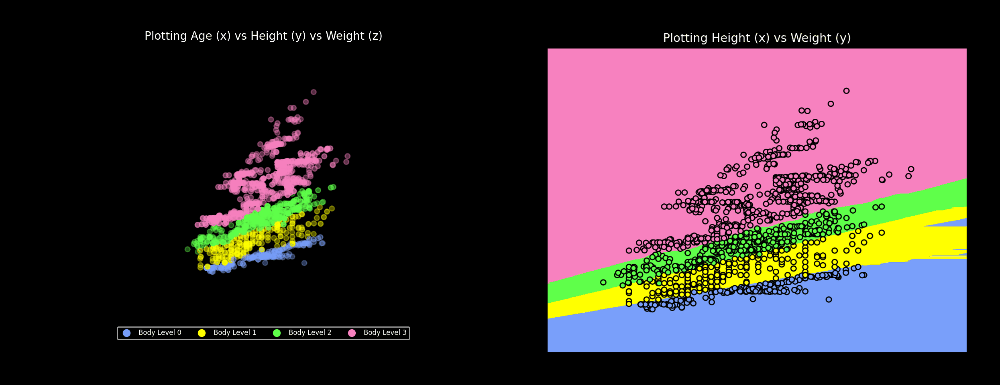

In [10]:
x_data_d=x_data_d[x_data_d.columns[[2, 1, 0]]]
print(x_data_d.columns)
VisualizeModel(model_name, x_data_d, y_data_d, clf).double_whammy(animated=True, useOld=False)